In [1]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True) # My Drive
# Change to your local path if needed
import os

Mounted at /content/gdrive


Drive for Code: https://drive.google.com/drive/folders/1-5hXs1sRm5pEZucITSQ9xk68zFAiJpZA?usp=sharing  

Drive for Dataset: https://drive.google.com/drive/folders/1-3JIhpRF97VD6ZvgHub0r9iSfMzyODKg?usp=sharing  


In [ ]:
!python --version

Python 3.7.13


In [2]:
import os

# os.chdir('/content')
CODE_DIR = '/content/gdrive/MyDrive/courses/CS275/TediGAN'
if not os.path.exists(CODE_DIR):
  !git clone https://github.com/weihaox/TediGAN.git $CODE_DIR
os.chdir(CODE_DIR)
MODEL_DIR = os.path.join('base', 'models', 'pretrain')
os.makedirs(MODEL_DIR, exist_ok=True)

# !pip install ftfy regex tqdm
# !pip install git+https://github.com/openai/CLIP.git

# download pretrained stylegan and encoder
!wget https://mycuhk-my.sharepoint.com/:u:/g/personal/1155082926_link_cuhk_edu_hk/EXqix_JIEgtLl1FXI4uCkr8B5GPaiJyiLXL6cFbdcIKqEA?e=WYesel\&download\=1 -O $MODEL_DIR/styleganinv_ffhq256_encoder.pth  --quiet
!wget https://mycuhk-my.sharepoint.com/:u:/g/personal/1155082926_link_cuhk_edu_hk/EbuzMQ3ZLl1AqvKJzeeBq7IBoQD-C1LfMIC8USlmOMPt3Q?e=CMXn8W\&download\=1 -O $MODEL_DIR/styleganinv_ffhq256_generator.pth  --quiet
!wget https://mycuhk-my.sharepoint.com/:u:/g/personal/1155082926_link_cuhk_edu_hk/EQJUz9DInbxEnp0aomkGGzAB5b3ZZbtsOA-TXct9E4ONqA?e=smtO0T\&download\=1 -O $MODEL_DIR/vgg16.pth  --quiet

!nvidia-smi

Sat Jun 18 15:26:37 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8    10W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-8l3gv5id
  Running command git clone -q https://github.com/openai/CLIP.git /tmp/pip-req-build-8l3gv5id
     |████████████████████████████████| 776.8 MB 17 kB/s 
     |████████████████████████████████| 59 kB 7.6 MB/s 
     |████████████████████████████████| 20.1 MB 1.4 MB/s 
     |████████████████████████████████| 57 kB 6.0 MB/s 
     |████████████████████████████████| 10.1 MB 13.5 MB/s 
     |████████████████████████████████| 1.5 MB 48.1 MB/s 
     |████████████████████████████████| 26.5 MB 1.5 MB/s 
     |████████████████████████████████| 28.2 MB 98.0 MB/s 
     |████████████████████████████████| 12.8 MB 30.5 MB/s 
     |████████████████████████████████| 13.1 MB 10.9 MB/s 
     |████████████████████████████████| 676 kB 69.5 MB/s 
     |████████████████████████████████| 123 kB 64.5 MB/s 
     |█████████████████████████████

In [1]:
%cd /content/gdrive/MyDrive/courses/CS275/TediGAN/base
%ls

/content/gdrive/MyDrive/courses/CS275/TediGAN/base
examples/  invert.py  models/  results/  streamlit_app.py  utils/


##Scratch experiments for repetition based approach

In [ ]:
model_name = 'styleganinv_ffhq256'  #@param {type:"string"}


[2022-06-17 10:45:02,889][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 10:45:03,082][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 10:45:03,362][INFO] Successfully loaded!
[2022-06-17 10:45:03,405][INFO] Current `lod` is 0.0.
[2022-06-17 10:45:03,405][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 10:45:04,388][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 10:45:06,111][INFO] Successfully loaded!
loss_pix: 0.037, loss_feat: 2478.341, loss_reg: 0.024, loss_clip: 0.672, loss: 2.225: 100% 200/200 [00:43<00:00,  4.61it/s]
save 29894 in results/inversion/test


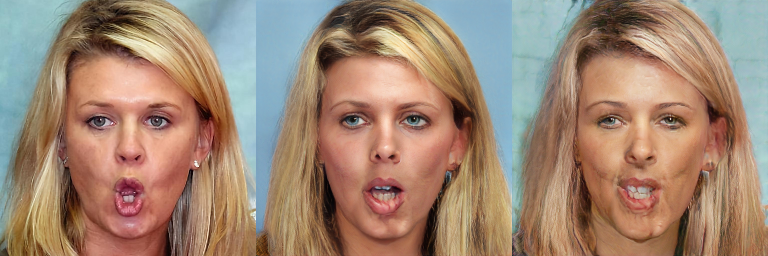

[2022-06-17 10:45:59,511][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 10:45:59,729][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 10:46:00,107][INFO] Successfully loaded!
[2022-06-17 10:46:00,149][INFO] Current `lod` is 0.0.
[2022-06-17 10:46:00,149][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 10:46:01,247][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 10:46:03,210][INFO] Successfully loaded!
loss_pix: 0.012, loss_feat: 940.069, loss_reg: 0.014, loss_clip: 0.675, loss: 1.774: 100% 100/100 [00:22<00:00,  4.52it/s]
save 29894_inv in results/inversion/test


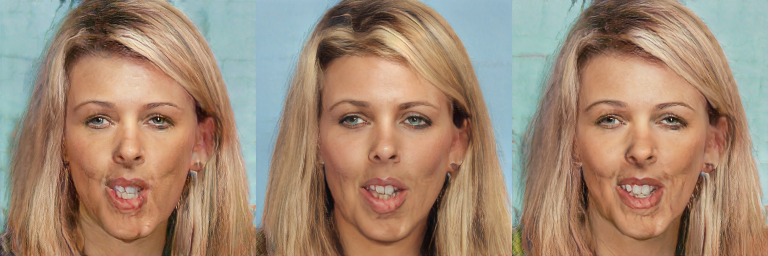

[2022-06-17 10:46:34,537][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 10:46:34,731][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 10:46:35,021][INFO] Successfully loaded!
[2022-06-17 10:46:35,064][INFO] Current `lod` is 0.0.
[2022-06-17 10:46:35,064][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 10:46:36,066][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 10:46:37,790][INFO] Successfully loaded!
loss_pix: 0.003, loss_feat: 332.787, loss_reg: 0.011, loss_clip: 0.667, loss: 1.374: 100% 100/100 [00:21<00:00,  4.56it/s]
save 29894_inv_inv in results/inversion/test


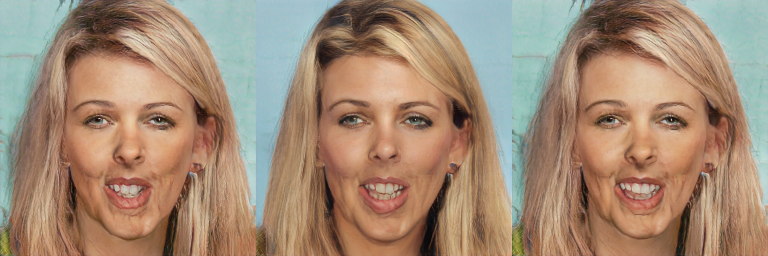

[2022-06-17 10:47:08,803][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 10:47:08,993][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 10:47:09,298][INFO] Successfully loaded!
[2022-06-17 10:47:09,340][INFO] Current `lod` is 0.0.
[2022-06-17 10:47:09,340][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 10:47:10,325][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 10:47:12,071][INFO] Successfully loaded!
loss_pix: 0.001, loss_feat: 134.454, loss_reg: 0.009, loss_clip: 0.663, loss: 1.021: 100% 100/100 [00:21<00:00,  4.57it/s]
save 29894_inv_inv_inv in results/inversion/test


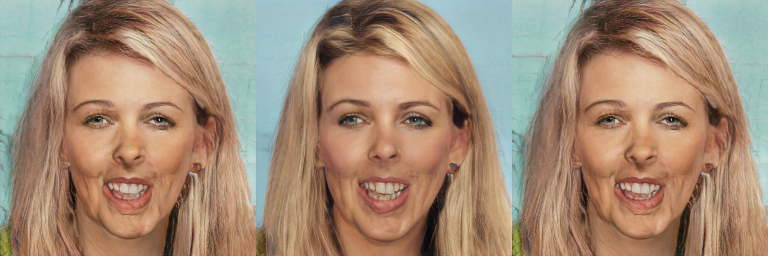

In [ ]:
description = 'She is smiling'  
loss_weight_clip = 3.0  
learning_rate = 0.01  
num_iterations = 200 

!python invert.py \
  --image_path='examples/29894.jpg' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

import cv2
import numpy as np
from google.colab.patches import cv2_imshow
original = cv2.imread('results/inversion/test/29894_ori.png')
inversion = cv2.imread('results/inversion/test/29894_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)


loss_weight_clip = 2.5
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)


loss_weight_clip = 2.0  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

loss_weight_clip = 1.5  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

[2022-06-17 08:13:39,016][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:13:39,206][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:13:39,495][INFO] Successfully loaded!
[2022-06-17 08:13:39,546][INFO] Current `lod` is 0.0.
[2022-06-17 08:13:39,546][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:13:40,527][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:13:42,294][INFO] Successfully loaded!
loss_pix: 0.037, loss_feat: 2787.835, loss_reg: 0.026, loss_clip: 0.628, loss: 2.112: 100% 200/200 [00:33<00:00,  5.93it/s]
save 29894 in results/inversion/test


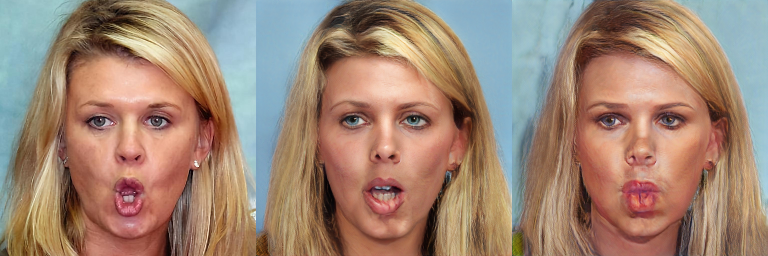

[2022-06-17 08:14:24,461][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:14:24,653][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:14:24,967][INFO] Successfully loaded!
[2022-06-17 08:14:25,011][INFO] Current `lod` is 0.0.
[2022-06-17 08:14:25,012][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:14:26,010][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:14:27,734][INFO] Successfully loaded!
loss_pix: 0.011, loss_feat: 840.050, loss_reg: 0.016, loss_clip: 0.624, loss: 1.645: 100% 100/100 [00:16<00:00,  5.92it/s]
save 29894_inv in results/inversion/test


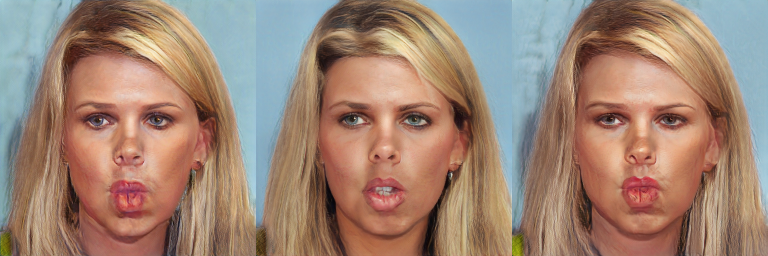

[2022-06-17 08:14:53,004][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:14:53,197][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:14:53,505][INFO] Successfully loaded!
[2022-06-17 08:14:53,550][INFO] Current `lod` is 0.0.
[2022-06-17 08:14:53,550][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:14:54,539][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:14:56,290][INFO] Successfully loaded!
loss_pix: 0.003, loss_feat: 362.092, loss_reg: 0.011, loss_clip: 0.664, loss: 1.371: 100% 100/100 [00:16<00:00,  5.91it/s]
save 29894_inv_inv in results/inversion/test


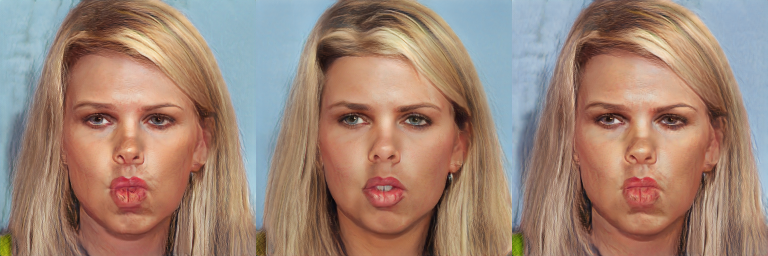

[2022-06-17 08:15:21,774][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:15:21,968][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:15:22,295][INFO] Successfully loaded!
[2022-06-17 08:15:22,340][INFO] Current `lod` is 0.0.
[2022-06-17 08:15:22,340][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:15:23,344][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:15:25,132][INFO] Successfully loaded!
loss_pix: 0.001, loss_feat: 125.290, loss_reg: 0.009, loss_clip: 0.660, loss: 1.016: 100% 100/100 [00:16<00:00,  5.90it/s]
save 29894_inv_inv_inv in results/inversion/test


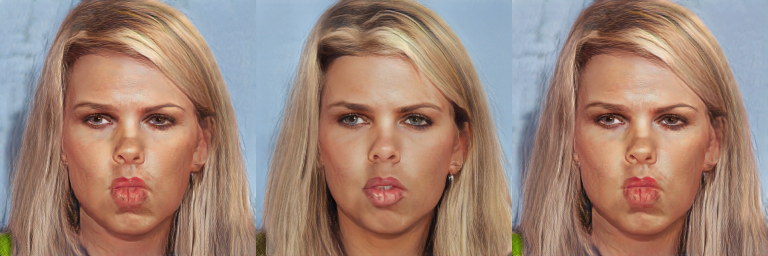

In [ ]:
description = 'She is angry and narrow lips'  
loss_weight_clip = 3.0  
learning_rate = 0.01  
num_iterations = 200 

!python invert.py \
  --image_path='examples/29894.jpg' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

import cv2
import numpy as np
from google.colab.patches import cv2_imshow
original = cv2.imread('results/inversion/test/29894_ori.png')
inversion = cv2.imread('results/inversion/test/29894_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)


loss_weight_clip = 2.5
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

description = "She is angry"
loss_weight_clip = 2.0  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

loss_weight_clip = 1.5  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

[2022-06-17 08:21:49,461][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:21:49,653][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:21:49,959][INFO] Successfully loaded!
[2022-06-17 08:21:50,007][INFO] Current `lod` is 0.0.
[2022-06-17 08:21:50,007][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:21:51,005][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:21:52,731][INFO] Successfully loaded!
loss_pix: 0.036, loss_feat: 2744.840, loss_reg: 0.027, loss_clip: 0.647, loss: 2.169: 100% 200/200 [00:33<00:00,  5.90it/s]
save 29894 in results/inversion/test


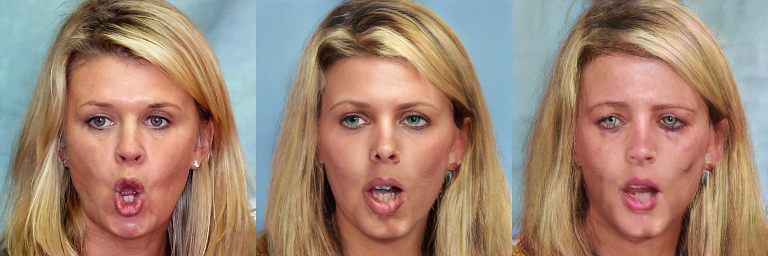

[2022-06-17 08:22:35,094][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:22:35,284][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:22:35,580][INFO] Successfully loaded!
[2022-06-17 08:22:35,631][INFO] Current `lod` is 0.0.
[2022-06-17 08:22:35,631][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:22:36,618][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:22:38,331][INFO] Successfully loaded!
loss_pix: 0.008, loss_feat: 750.928, loss_reg: 0.016, loss_clip: 0.646, loss: 1.695: 100% 100/100 [00:16<00:00,  5.93it/s]
save 29894_inv in results/inversion/test


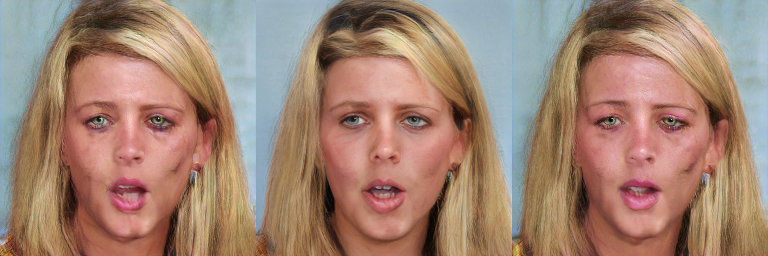

[2022-06-17 08:23:03,573][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:23:03,761][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:23:04,067][INFO] Successfully loaded!
[2022-06-17 08:23:04,111][INFO] Current `lod` is 0.0.
[2022-06-17 08:23:04,111][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:23:05,097][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:23:06,839][INFO] Successfully loaded!
loss_pix: 0.005, loss_feat: 548.194, loss_reg: 0.012, loss_clip: 0.645, loss: 1.346: 100% 100/100 [00:16<00:00,  5.91it/s]
save 29894_inv_inv in results/inversion/test


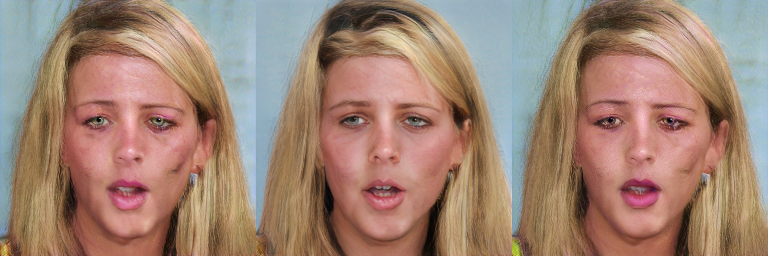

[2022-06-17 08:23:32,278][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:23:32,469][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:23:32,769][INFO] Successfully loaded!
[2022-06-17 08:23:32,827][INFO] Current `lod` is 0.0.
[2022-06-17 08:23:32,827][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:23:33,814][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:23:35,565][INFO] Successfully loaded!
loss_pix: 0.001, loss_feat: 123.218, loss_reg: 0.009, loss_clip: 0.641, loss: 0.987: 100% 100/100 [00:16<00:00,  5.92it/s]
save 29894_inv_inv_inv in results/inversion/test


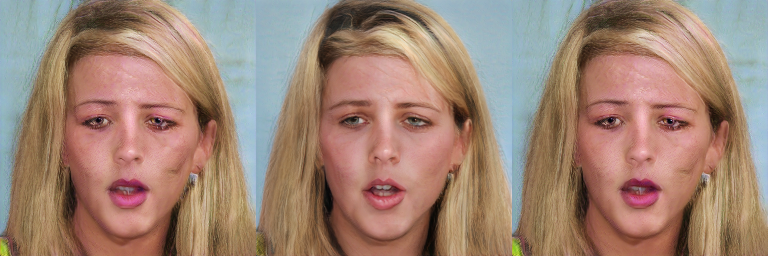

In [ ]:
description = 'She is crying and bags under eyes'  
loss_weight_clip = 3.0  
learning_rate = 0.01  
num_iterations = 200 

!python invert.py \
  --image_path='examples/29894.jpg' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

import cv2
import numpy as np
from google.colab.patches import cv2_imshow
original = cv2.imread('results/inversion/test/29894_ori.png')
inversion = cv2.imread('results/inversion/test/29894_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

description = 'She is crying and bags under eyes' 
loss_weight_clip = 2.5
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

description = 'She is crying with arched eyebrows and narrow lips' 
loss_weight_clip = 2.0  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

loss_weight_clip = 1.5  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

[2022-06-17 08:27:30,952][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:27:31,144][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:27:31,448][INFO] Successfully loaded!
[2022-06-17 08:27:31,501][INFO] Current `lod` is 0.0.
[2022-06-17 08:27:31,502][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:27:32,495][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:27:34,254][INFO] Successfully loaded!
loss_pix: 0.036, loss_feat: 2528.867, loss_reg: 0.028, loss_clip: 0.648, loss: 2.163: 100% 200/200 [00:33<00:00,  5.92it/s]
save 29894 in results/inversion/test


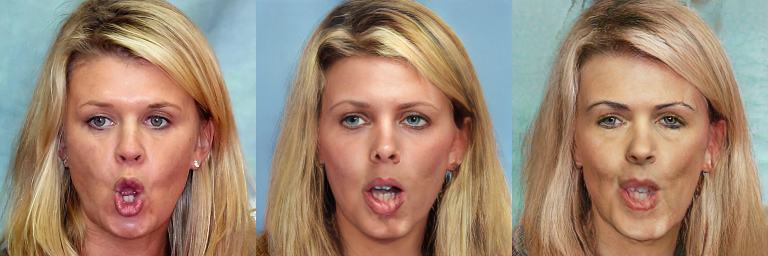

[2022-06-17 08:28:16,520][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:28:16,709][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:28:17,016][INFO] Successfully loaded!
[2022-06-17 08:28:17,065][INFO] Current `lod` is 0.0.
[2022-06-17 08:28:17,065][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:28:18,056][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:28:19,761][INFO] Successfully loaded!
loss_pix: 0.010, loss_feat: 904.300, loss_reg: 0.015, loss_clip: 0.662, loss: 1.740: 100% 100/100 [00:16<00:00,  5.91it/s]
save 29894_inv in results/inversion/test


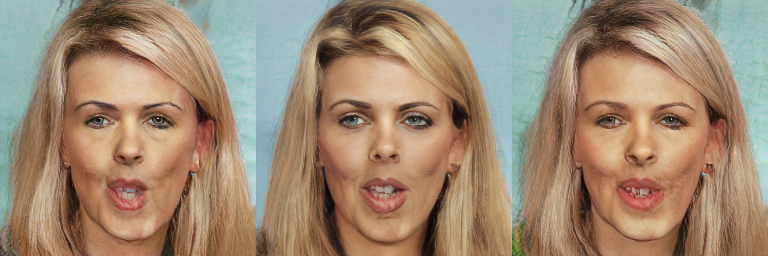

[2022-06-17 08:28:45,113][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:28:45,306][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:28:45,600][INFO] Successfully loaded!
[2022-06-17 08:28:45,648][INFO] Current `lod` is 0.0.
[2022-06-17 08:28:45,648][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:28:46,684][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:28:48,602][INFO] Successfully loaded!
loss_pix: 0.003, loss_feat: 316.927, loss_reg: 0.011, loss_clip: 0.671, loss: 1.383: 100% 100/100 [00:16<00:00,  5.93it/s]
save 29894_inv_inv in results/inversion/test


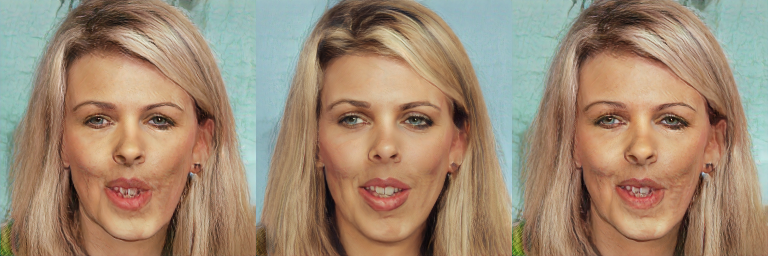

[2022-06-17 08:29:13,869][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 08:29:14,061][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 08:29:14,366][INFO] Successfully loaded!
[2022-06-17 08:29:14,415][INFO] Current `lod` is 0.0.
[2022-06-17 08:29:14,415][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 08:29:15,404][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 08:29:17,136][INFO] Successfully loaded!
loss_pix: 0.001, loss_feat: 101.167, loss_reg: 0.010, loss_clip: 0.666, loss: 1.024: 100% 100/100 [00:16<00:00,  5.91it/s]
save 29894_inv_inv_inv in results/inversion/test


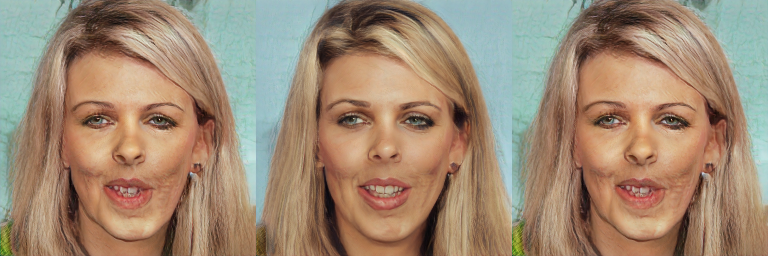

In [ ]:
description = 'She is smiling and arched eyebrows'  
loss_weight_clip = 3.0  
learning_rate = 0.01  
num_iterations = 200 

!python invert.py \
  --image_path='examples/29894.jpg' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

import cv2
import numpy as np
from google.colab.patches import cv2_imshow
original = cv2.imread('results/inversion/test/29894_ori.png')
inversion = cv2.imread('results/inversion/test/29894_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

description = 'She is smiling and narrow lips'  
loss_weight_clip = 2.5
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

description = 'She is smiling and narrow eyes' 
loss_weight_clip = 2.0  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

loss_weight_clip = 1.5  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

[2022-06-17 09:04:23,284][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 09:04:23,472][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 09:04:23,785][INFO] Successfully loaded!
[2022-06-17 09:04:23,835][INFO] Current `lod` is 0.0.
[2022-06-17 09:04:23,835][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 09:04:24,821][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 09:04:26,535][INFO] Successfully loaded!
loss_pix: 0.037, loss_feat: 2728.063, loss_reg: 0.029, loss_clip: 0.590, loss: 2.001: 100% 200/200 [00:33<00:00,  5.91it/s]
save 29894 in results/inversion/test


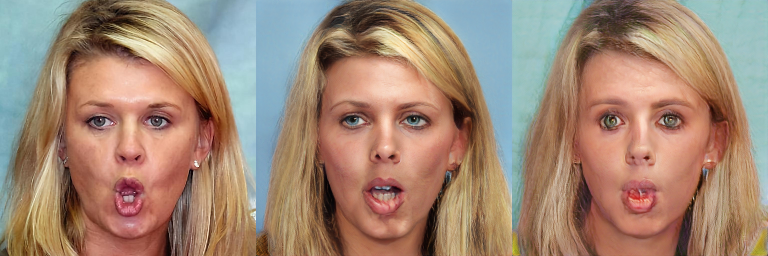

[2022-06-17 09:05:08,831][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 09:05:09,021][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 09:05:09,342][INFO] Successfully loaded!
[2022-06-17 09:05:09,388][INFO] Current `lod` is 0.0.
[2022-06-17 09:05:09,389][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 09:05:10,384][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 09:05:12,091][INFO] Successfully loaded!
loss_pix: 0.008, loss_feat: 802.727, loss_reg: 0.016, loss_clip: 0.599, loss: 1.576: 100% 100/100 [00:16<00:00,  5.92it/s]
save 29894_inv in results/inversion/test


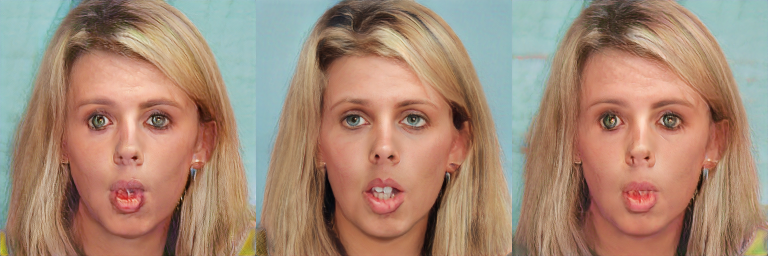

[2022-06-17 09:05:37,506][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 09:05:37,697][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 09:05:37,994][INFO] Successfully loaded!
[2022-06-17 09:05:38,040][INFO] Current `lod` is 0.0.
[2022-06-17 09:05:38,040][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 09:05:39,026][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 09:05:40,727][INFO] Successfully loaded!
loss_pix: 0.005, loss_feat: 612.493, loss_reg: 0.014, loss_clip: 0.622, loss: 1.307: 100% 100/100 [00:16<00:00,  5.90it/s]
save 29894_inv_inv in results/inversion/test


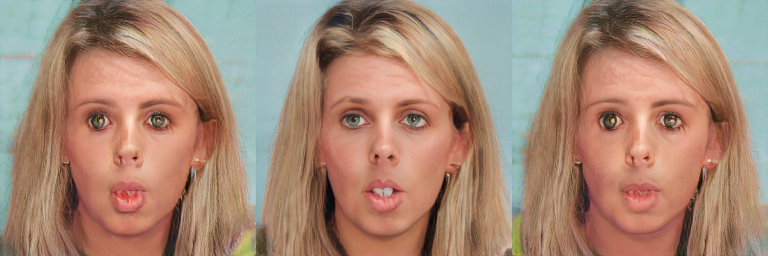

[2022-06-17 09:06:06,128][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 09:06:06,317][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 09:06:06,623][INFO] Successfully loaded!
[2022-06-17 09:06:06,666][INFO] Current `lod` is 0.0.
[2022-06-17 09:06:06,667][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 09:06:07,650][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 09:06:09,337][INFO] Successfully loaded!
loss_pix: 0.002, loss_feat: 192.551, loss_reg: 0.011, loss_clip: 0.615, loss: 0.956: 100% 100/100 [00:16<00:00,  5.91it/s]
save 29894_inv_inv_inv in results/inversion/test


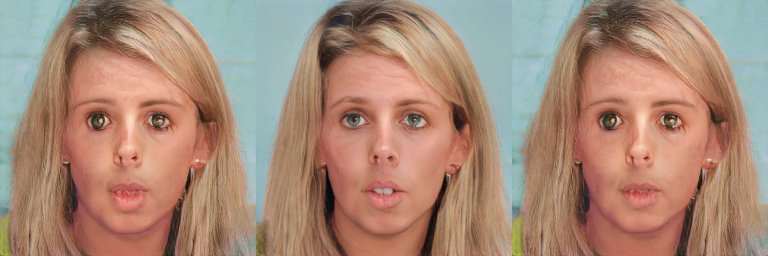

In [ ]:
description = 'She has mouth slightly open and big eyes'  
loss_weight_clip = 3.0  
learning_rate = 0.01  
num_iterations = 200 

!python invert.py \
  --image_path='examples/29894.jpg' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

import cv2
import numpy as np
from google.colab.patches import cv2_imshow
original = cv2.imread('results/inversion/test/29894_ori.png')
inversion = cv2.imread('results/inversion/test/29894_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

description = 'She has mouth slightly open and big eyes'  
loss_weight_clip = 2.5
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

description = 'She has big eyes and smiling and sad' 
loss_weight_clip = 2.0  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

loss_weight_clip = 1.5  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

[2022-06-17 09:13:03,347][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 09:13:03,545][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 09:13:03,855][INFO] Successfully loaded!
[2022-06-17 09:13:03,899][INFO] Current `lod` is 0.0.
[2022-06-17 09:13:03,899][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 09:13:04,884][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 09:13:06,566][INFO] Successfully loaded!
loss_pix: 0.037, loss_feat: 2477.938, loss_reg: 0.025, loss_clip: 0.633, loss: 2.110: 100% 200/200 [00:33<00:00,  5.92it/s]
save 29894 in results/inversion/test


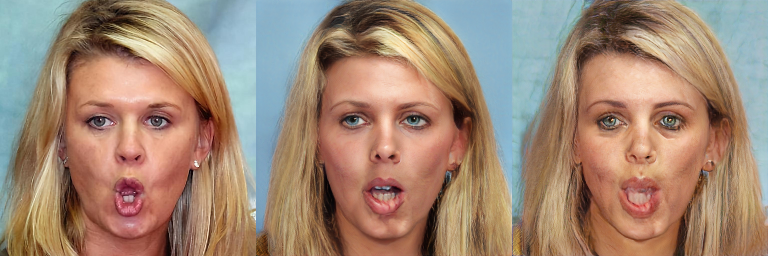

[2022-06-17 09:13:48,880][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 09:13:49,072][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 09:13:49,393][INFO] Successfully loaded!
[2022-06-17 09:13:49,436][INFO] Current `lod` is 0.0.
[2022-06-17 09:13:49,436][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 09:13:50,421][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 09:13:52,111][INFO] Successfully loaded!
loss_pix: 0.010, loss_feat: 962.430, loss_reg: 0.016, loss_clip: 0.626, loss: 1.653: 100% 100/100 [00:16<00:00,  5.91it/s]
save 29894_inv in results/inversion/test


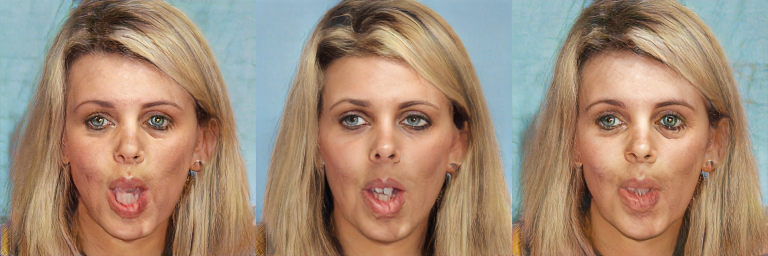

[2022-06-17 09:14:17,454][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 09:14:17,644][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 09:14:17,951][INFO] Successfully loaded!
[2022-06-17 09:14:17,994][INFO] Current `lod` is 0.0.
[2022-06-17 09:14:17,994][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 09:14:18,985][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 09:14:20,691][INFO] Successfully loaded!
loss_pix: 0.002, loss_feat: 261.250, loss_reg: 0.012, loss_clip: 0.616, loss: 1.273: 100% 100/100 [00:16<00:00,  5.91it/s]
save 29894_inv_inv in results/inversion/test


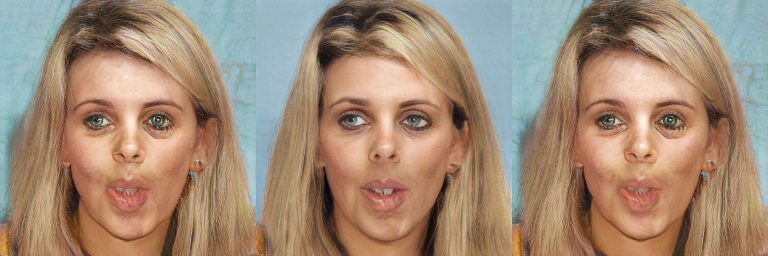

[2022-06-17 09:14:46,106][INFO] Build network for module `generator` in model `styleganinv_ffhq256`.
[2022-06-17 09:14:46,294][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_generator.pth`.
[2022-06-17 09:14:46,607][INFO] Successfully loaded!
[2022-06-17 09:14:46,652][INFO] Current `lod` is 0.0.
[2022-06-17 09:14:46,652][INFO] Build network for module `encoder` in model `styleganinv_ffhq256`.
[2022-06-17 09:14:47,653][INFO] Loading pytorch weights from `models/pretrain/styleganinv_ffhq256_encoder.pth`.
[2022-06-17 09:14:49,368][INFO] Successfully loaded!
loss_pix: 0.001, loss_feat: 133.880, loss_reg: 0.012, loss_clip: 0.609, loss: 0.946: 100% 100/100 [00:16<00:00,  5.90it/s]
save 29894_inv_inv_inv in results/inversion/test


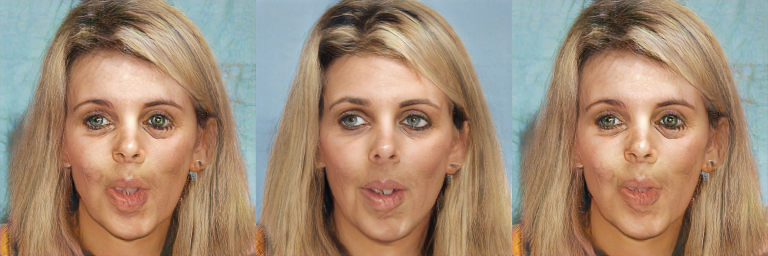

In [ ]:
description = 'She is smiling and mouth open and big eyes'  
loss_weight_clip = 3.0  
learning_rate = 0.01  
num_iterations = 200 

!python invert.py \
  --image_path='examples/29894.jpg' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

import cv2
import numpy as np
from google.colab.patches import cv2_imshow
original = cv2.imread('results/inversion/test/29894_ori.png')
inversion = cv2.imread('results/inversion/test/29894_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

description = 'She is smiling and big eyes'  
# description = 'She has mouth open and big eyes'  
loss_weight_clip = 2.5
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

# description = 'She has mouth open and bags under eyes' 
loss_weight_clip = 2.0  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

loss_weight_clip = 1.5  
learning_rate = 0.01  
num_iterations = 100 

!python invert.py \
  --image_path='results/inversion/test/29894_inv_inv_inv.png' \
  --model_name={model_name} \
  --mode='man' \
  --description=f'{description}' \
  --learning_rate={learning_rate} \
  --num_iterations={num_iterations} \
  --loss_weight_clip={loss_weight_clip}

original = cv2.imread('results/inversion/test/29894_inv_inv_inv_ori.png')
inversion = cv2.imread('results/inversion/test/29894_inv_inv_inv_enc.png')
manipulation = cv2.imread('results/inversion/test/29894_inv_inv_inv_inv.png')
result = np.hstack([original, inversion, manipulation])
cv2_imshow(result)

python invert.py --image_path=examples/29894.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/29894_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/29894_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/29894_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


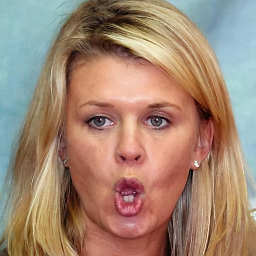

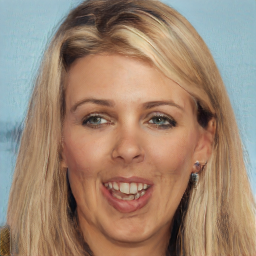

python invert.py --image_path=examples/29894.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


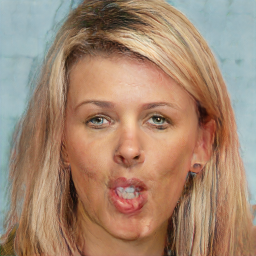

joy
['original', 'joy']


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
emotions = ["joy","sadness","anger","love","fear","surprise"]
gender = "She"
descr_dict = {"joy":["The person is smiling","The person is smiling","The person is smiling","The person is smiling"],
              "sadness":['The person is crying and bags under eyes' ,'The person is crying and bags under eyes' ,"The person is crying with arched eyebrows and narrow lips","The person is crying with arched eyebrows and narrow lips"],
              "anger":['The person is angry and narrow lips','The person is angry and narrow lips',"The person is angry","The person is angry"],
              "love":['The person is smiling and arched eyebrows','The person is smiling and narrow lips','The person is smiling and narrow eyes','The person is smiling and narrow eyes'],
              "fear":['The person has mouth slightly open and big eyes','The person has mouth slightly open and big eyes','The person has big eyes and smiling and sad' ,'The person has big eyes and smiling and sad'  ],
              "surprise":['The person is smiling and mouth open and big eyes','The person is smiling and big eyes','The person is smiling and big eyes','The person is smiling and big eyes' ]}
og_dict = {"joy":"The person is smiling","sadness":"The person is sad","anger":"The person is angry","love":"The person is in love","fear":"The person is afraid","surprise":"The person is surprised"}
clip_rate_list = [3.0,2.5,2.0,1.5]
iter_list = [200,100,100,100]
show_orig=True
image_path = "examples/29894.jpg"
model_name = "styleganinv_ffhq256"
img_name = image_path[image_path.index("/")+1:image_path.index(".")]
result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
og_result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
impath_list = [image_path,"results/inversion/test/"+img_name+"_inv.png", "results/inversion/test/"+img_name+"_inv_inv.png", "results/inversion/test/"+img_name+"_inv_inv_inv.png" ]
labels = ["original"]
# cv2_imshow(cv2.imread(image_path))
for emotion in ["joy"]:
  desc_list = descr_dict[emotion]
  initial = image_path
  final = "results/inversion/test/"+img_name+"_inv_inv_inv_enc.png"
  for i in range(len(desc_list)):
    desc = desc_list[i].replace("The person",gender)
    clip = clip_rate_list[i]
    iter = iter_list[i]
    command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(impath_list[i], model_name, desc, iter, clip)
    print(command)
    # os.system(command)
  # if (show_orig):
    # cv2_imshow(cv2.imread("results/inversion/test/"+img_name+"_ori.png"))
    # show_orig=False
  # cv2_imshow(cv2.imread(final))
  # result_images.append(cv2.imread(final))

  og_desc = og_dict[emotion].replace("The person",gender)
  command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(image_path, model_name, og_desc, 200, 2.0)
  print(command)
  os.system(command)
  cv2_imshow(cv2.imread("results/inversion/test/"+img_name+"_inv.png"))
  # og_result_images.append(cv2.imread(final))

  labels.append(emotion)
  print(emotion)

# result_v = np.hstack(result_images)
# result_vog = np.hstack(og_result_images)
# cv2_imshow(result_v)
# cv2_imshow(result_vog)
print(labels)

##Generating comparisons between single pass and repitition based


python invert.py --image_path=examples/29894.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/29894_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/29894_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/29894_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5
python invert.py --image_path=examples/29894.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is happy' --learning_rate=0.01 --num_iterations=200

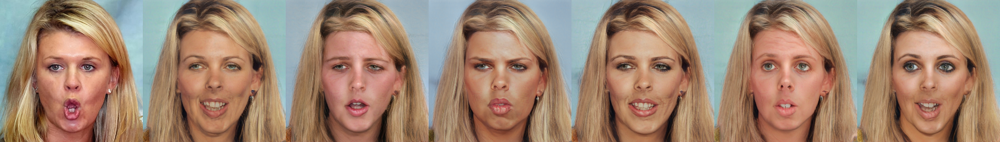

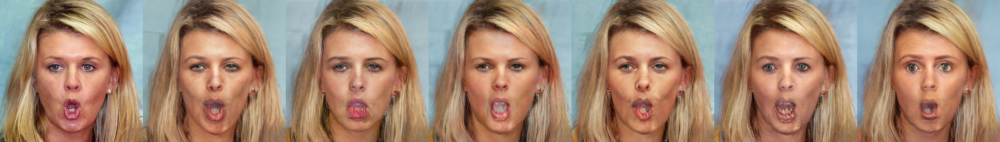

['original', 'joy', 'sadness', 'anger', 'love', 'fear', 'surprise']


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
emotions = ["joy","sadness","anger","love","fear","surprise"]
gender = "She"
descr_dict = {"joy":["The person is smiling","The person is smiling","The person is smiling","The person is smiling"],
              "sadness":['The person is crying and bags under eyes' ,'The person is crying and bags under eyes' ,"The person is crying with arched eyebrows and narrow lips","The person is crying with arched eyebrows and narrow lips"],
              "anger":['The person is angry and narrow lips','The person is angry and narrow lips',"The person is angry","The person is angry"],
              "love":['The person is smiling and arched eyebrows','The person is smiling and narrow lips','The person is smiling and narrow eyes','The person is smiling and narrow eyes'],
              "fear":['The person has mouth slightly open and big eyes','The person has mouth slightly open and big eyes','The person has big eyes and smiling and sad' ,'The person has big eyes and smiling and sad'  ],
              "surprise":['The person is smiling and mouth open and big eyes','The person is smiling and big eyes','The person is smiling and big eyes','The person is smiling and big eyes' ]}
og_dict = {"joy":"The person is happy","sadness":"The person is sad","anger":"The person is angry","love":"The person is in love","fear":"The person is afraid","surprise":"The person is surprised"}
clip_rate_list = [3.0,2.5,2.0,1.5]
iter_list = [200,100,100,100]
show_orig=True
image_path = "examples/29894.jpg"
model_name = "styleganinv_ffhq256"
img_name = image_path[image_path.index("/")+1:image_path.index(".")]
result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
og_result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
impath_list = [image_path,"results/inversion/test/"+img_name+"_inv.png", "results/inversion/test/"+img_name+"_inv_inv.png", "results/inversion/test/"+img_name+"_inv_inv_inv.png" ]
labels = ["original"]
for emotion in emotions:
  desc_list = descr_dict[emotion]
  initial = image_path
  final = "results/inversion/test/"+img_name+"_inv_inv_inv_enc.png"
  for i in range(len(desc_list)):
    desc = desc_list[i].replace("The person",gender)
    clip = clip_rate_list[i]
    iter = iter_list[i]
    command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(impath_list[i], model_name, desc, iter, clip)
    print(command)
    os.system(command)
  result_images.append(cv2.imread(final))

  og_desc = og_dict[emotion].replace("The person",gender)
  command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(image_path, model_name, og_desc, 200, 2.0)
  print(command)
  os.system(command)
  og_result_images.append(cv2.imread("results/inversion/test/"+img_name+"_inv.png"))

  labels.append(emotion)
  print(emotion)

result_v = np.hstack(result_images)
result_vog = np.hstack(og_result_images)
cv2_imshow(result_v)
cv2_imshow(result_vog)
print(labels)

python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/20_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/20_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/20_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


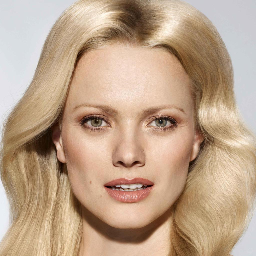

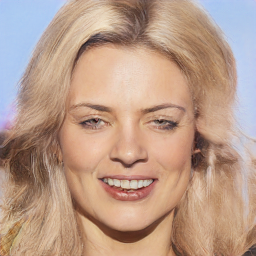

python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is happy' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


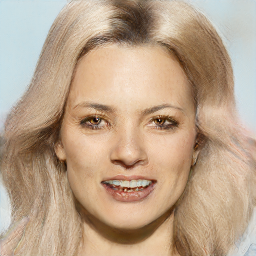

joy
python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is crying and bags under eyes' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/20_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is crying and bags under eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/20_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is crying with arched eyebrows and narrow lips' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/20_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is crying with arched eyebrows and narrow lips' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


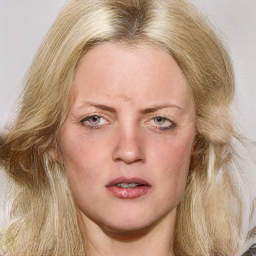

python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is sad' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


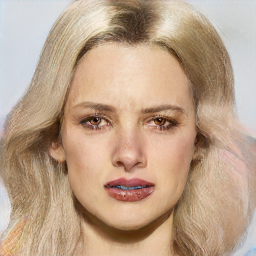

sadness
python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry and narrow lips' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/20_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry and narrow lips' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/20_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/20_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


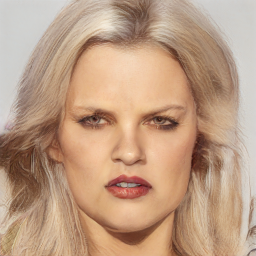

python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


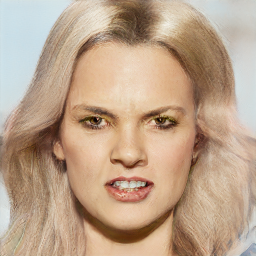

anger
python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and arched eyebrows' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/20_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and narrow lips' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/20_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and narrow eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/20_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and narrow eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


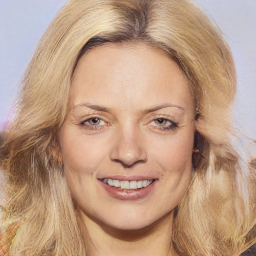

python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is in love' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


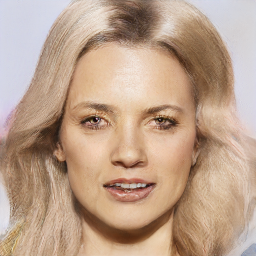

love
python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has mouth slightly open and big eyes' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/20_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has mouth slightly open and big eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/20_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has big eyes and smiling and sad' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/20_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has big eyes and smiling and sad' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


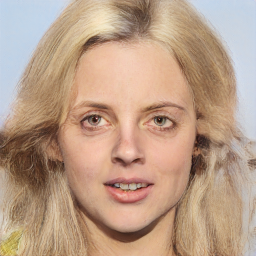

python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is afraid' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


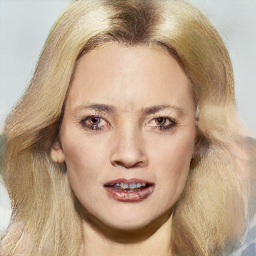

fear
python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and mouth open and big eyes' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/20_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and big eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/20_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and big eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/20_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and big eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


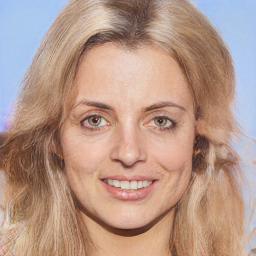

python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is surprised' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


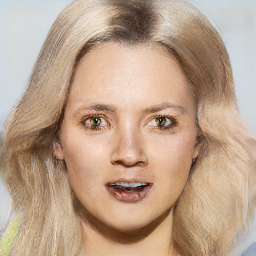

surprise
['original', 'joy', 'sadness', 'anger', 'love', 'fear', 'surprise']


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
emotions = ["joy","sadness","anger","love","fear","surprise"]
gender = "She"
descr_dict = {"joy":["The person is smiling","The person is smiling","The person is smiling","The person is smiling"],
              "sadness":['The person is crying and bags under eyes' ,'The person is crying and bags under eyes' ,"The person is crying with arched eyebrows and narrow lips","The person is crying with arched eyebrows and narrow lips"],
              "anger":['The person is angry and narrow lips','The person is angry and narrow lips',"The person is angry","The person is angry"],
              "love":['The person is smiling and arched eyebrows','The person is smiling and narrow lips','The person is smiling and narrow eyes','The person is smiling and narrow eyes'],
              "fear":['The person has mouth slightly open and big eyes','The person has mouth slightly open and big eyes','The person has big eyes and smiling and sad' ,'The person has big eyes and smiling and sad'  ],
              "surprise":['The person is smiling and mouth open and big eyes','The person is smiling and big eyes','The person is smiling and big eyes','The person is smiling and big eyes' ]}
og_dict = {"joy":"The person is happy","sadness":"The person is sad","anger":"The person is angry","love":"The person is in love","fear":"The person is afraid","surprise":"The person is surprised"}
clip_rate_list = [3.0,2.5,2.0,1.5]
iter_list = [200,100,100,100]
show_orig=True
image_path = "examples/20.jpg"
model_name = "styleganinv_ffhq256"
img_name = image_path[image_path.index("/")+1:image_path.index(".")]
# result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
# og_result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
impath_list = [image_path,"results/inversion/test/"+img_name+"_inv.png", "results/inversion/test/"+img_name+"_inv_inv.png", "results/inversion/test/"+img_name+"_inv_inv_inv.png" ]
labels = ["original"]
# cv2_imshow(cv2.imread(image_path))
for emotion in emotions:
  desc_list = descr_dict[emotion]
  initial = image_path
  final = "results/inversion/test/"+img_name+"_inv_inv_inv_enc.png"
  for i in range(len(desc_list)):
    desc = desc_list[i].replace("The person",gender)
    clip = clip_rate_list[i]
    iter = iter_list[i]
    command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(impath_list[i], model_name, desc, iter, clip)
    print(command)
    os.system(command)
  if (show_orig):
    cv2_imshow(cv2.imread("results/inversion/test/"+img_name+"_ori.png"))
    show_orig=False
  cv2_imshow(cv2.imread(final))
  # result_images.append(cv2.imread(final))

  og_desc = og_dict[emotion].replace("The person",gender)
  command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(image_path, model_name, og_desc, 200, 2.0)
  print(command)
  os.system(command)
  cv2_imshow(cv2.imread("results/inversion/test/"+img_name+"_inv.png"))
  # og_result_images.append(cv2.imread(final))

  labels.append(emotion)
  print(emotion)

# result_v = np.hstack(result_images)
# result_vog = np.hstack(og_result_images)
# cv2_imshow(result_v)
# cv2_imshow(result_vog)
print(labels)

python invert.py --image_path=examples/39.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'He is smiling' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/39_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'He is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/39_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'He is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/39_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'He is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5
python invert.py --image_path=examples/39.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'He is happy' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=

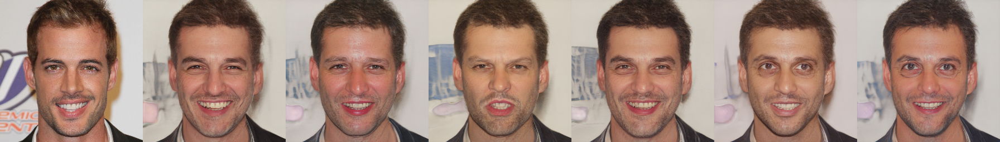

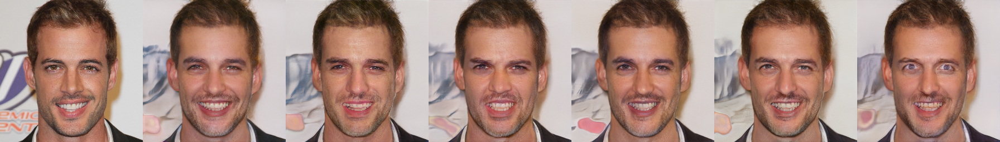

['original', 'joy', 'sadness', 'anger', 'love', 'fear', 'surprise']


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
emotions = ["joy","sadness","anger","love","fear","surprise"]
gender = "He"
descr_dict = {"joy":["The person is smiling","The person is smiling","The person is smiling","The person is smiling"],
              "sadness":['The person is crying and bags under eyes' ,'The person is crying and bags under eyes' ,"The person is crying with arched eyebrows and narrow lips","The person is crying with arched eyebrows and narrow lips"],
              "anger":['The person is angry and narrow lips','The person is angry and narrow lips',"The person is angry","The person is angry"],
              "love":['The person is in love, smiling and arched eyebrows','The person is in love, smiling and narrow lips','The person is in love, smiling and narrow eyes','The person is smiling and narrow eyes'],
              "fear":['The person is afraid, has mouth slightly open and big eyes','The person is afraid, has mouth slightly open and big eyes','The person is afraid, has big eyes and smiling and sad' ,'The person is afraid, has big eyes and smiling and sad'  ],
              "surprise":['The person is surprised, smiling and mouth open and big eyes','The person is surprised, smiling and big eyes','The person is surprised, smiling and big eyes','The person is smiling and big eyes' ]}
og_dict = {"joy":"The person is happy","sadness":"The person is sad","anger":"The person is angry","love":"The person is in love","fear":"The person is afraid","surprise":"The person is surprised"}
clip_rate_list = [3.0,2.5,2.0,1.5]
iter_list = [200,100,100,100]
show_orig=True
image_path = "examples/39.jpg"
model_name = "styleganinv_ffhq256"
img_name = image_path[image_path.index("/")+1:image_path.index(".")]
result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
og_result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
impath_list = [image_path,"results/inversion/test/"+img_name+"_inv.png", "results/inversion/test/"+img_name+"_inv_inv.png", "results/inversion/test/"+img_name+"_inv_inv_inv.png" ]
labels = ["original"]
for emotion in emotions:
  desc_list = descr_dict[emotion]
  initial = image_path
  final = "results/inversion/test/"+img_name+"_inv_inv_inv_enc.png"
  for i in range(len(desc_list)):
    desc = desc_list[i].replace("The person",gender)
    clip = clip_rate_list[i]
    iter = iter_list[i]
    command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(impath_list[i], model_name, desc, iter, clip)
    print(command)
    os.system(command)
  result_images.append(cv2.imread(final))

  og_desc = og_dict[emotion].replace("The person",gender)
  command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(image_path, model_name, og_desc, 200, 2.0)
  print(command)
  os.system(command)
  og_result_images.append(cv2.imread("results/inversion/test/"+img_name+"_inv.png"))

  labels.append(emotion)
  print(emotion)

result_v = np.hstack(result_images)
result_vog = np.hstack(og_result_images)
cv2_imshow(result_v)
cv2_imshow(result_vog)
print(labels)

python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/29007_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/29007_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/29007_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


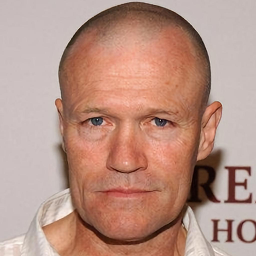

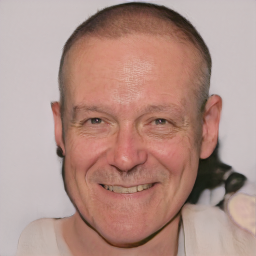

python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is happy' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


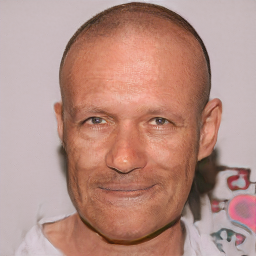

joy
python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is crying and bags under eyes' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/29007_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is crying and bags under eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/29007_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is crying with arched eyebrows and narrow lips' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/29007_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is crying with arched eyebrows and narrow lips' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


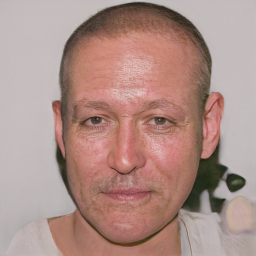

python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is sad' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


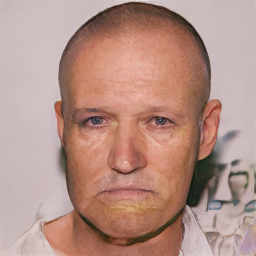

sadness
python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry and narrow lips' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/29007_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry and narrow lips' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/29007_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/29007_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


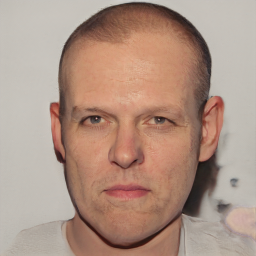

python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is angry' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


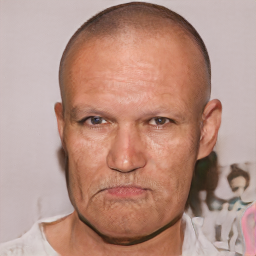

anger
python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and arched eyebrows' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/29007_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and narrow lips' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/29007_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and narrow eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/29007_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and narrow eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


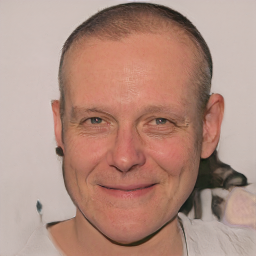

python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is in love' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


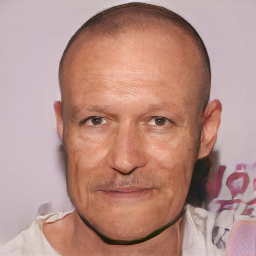

love
python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has mouth slightly open and big eyes' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/29007_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has mouth slightly open and big eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/29007_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has big eyes and smiling and sad' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/29007_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has big eyes and smiling and sad' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


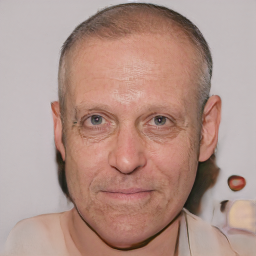

python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is afraid' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


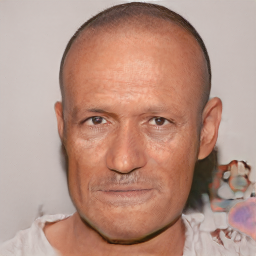

fear
python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and mouth open and big eyes' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=3.0
python invert.py --image_path=results/inversion/test/29007_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and big eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/29007_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and big eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/29007_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and big eyes' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=1.5


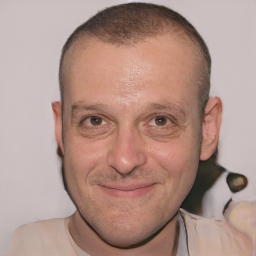

python invert.py --image_path=examples/29007.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is surprised' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.0


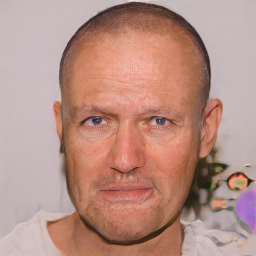

surprise
['original', 'joy', 'sadness', 'anger', 'love', 'fear', 'surprise']


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
emotions = ["joy","sadness","anger","love","fear","surprise"]
gender = "She"
descr_dict = {"joy":["The person is smiling","The person is smiling","The person is smiling","The person is smiling"],
              "sadness":['The person is crying and bags under eyes' ,'The person is crying and bags under eyes' ,"The person is crying with arched eyebrows and narrow lips","The person is crying with arched eyebrows and narrow lips"],
              "anger":['The person is angry and narrow lips','The person is angry and narrow lips',"The person is angry","The person is angry"],
              "love":['The person is smiling and arched eyebrows','The person is smiling and narrow lips','The person is smiling and narrow eyes','The person is smiling and narrow eyes'],
              "fear":['The person has mouth slightly open and big eyes','The person has mouth slightly open and big eyes','The person has big eyes and smiling and sad' ,'The person has big eyes and smiling and sad'  ],
              "surprise":['The person is smiling and mouth open and big eyes','The person is smiling and big eyes','The person is smiling and big eyes','The person is smiling and big eyes' ]}
og_dict = {"joy":"The person is happy","sadness":"The person is sad","anger":"The person is angry","love":"The person is in love","fear":"The person is afraid","surprise":"The person is surprised"}
clip_rate_list = [3.0,2.5,2.0,1.5]
iter_list = [200,100,100,100]
show_orig=True
image_path = "examples/29007.jpg"
model_name = "styleganinv_ffhq256"
img_name = image_path[image_path.index("/")+1:image_path.index(".")]
# result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
# og_result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
impath_list = [image_path,"results/inversion/test/"+img_name+"_inv.png", "results/inversion/test/"+img_name+"_inv_inv.png", "results/inversion/test/"+img_name+"_inv_inv_inv.png" ]
labels = ["original"]
# cv2_imshow(cv2.imread(image_path))
for emotion in emotions:
  desc_list = descr_dict[emotion]
  initial = image_path
  final = "results/inversion/test/"+img_name+"_inv_inv_inv_enc.png"
  for i in range(len(desc_list)):
    desc = desc_list[i].replace("The person",gender)
    clip = clip_rate_list[i]
    iter = iter_list[i]
    command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(impath_list[i], model_name, desc, iter, clip)
    print(command)
    os.system(command)
  if (show_orig):
    cv2_imshow(cv2.imread("results/inversion/test/"+img_name+"_ori.png"))
    show_orig=False
  cv2_imshow(cv2.imread(final))
  # result_images.append(cv2.imread(final))

  og_desc = og_dict[emotion].replace("The person",gender)
  command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(image_path, model_name, og_desc, 200, 2.0)
  print(command)
  os.system(command)
  cv2_imshow(cv2.imread("results/inversion/test/"+img_name+"_inv.png"))
  # og_result_images.append(cv2.imread(final))

  labels.append(emotion)
  print(emotion)

# result_v = np.hstack(result_images)
# result_vog = np.hstack(og_result_images)
# cv2_imshow(result_v)
# cv2_imshow(result_vog)
print(labels)

#Out of dataset example (image pre-aligned in seperate notebook)

results/inversion/test/574_01_ori.png
python invert.py --image_path=examples/574_01.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'He is smiling and mouth open' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/574_01_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'He has mouth slightly open' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/574_01_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'He is smiling' --learning_rate=0.01 --num_iterations=50 --loss_weight_clip=1.5
python invert.py --image_path=results/inversion/test/574_01_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'He is smiling' --learning_rate=0.01 --num_iterations=50 --loss_weight_clip=1.0
python invert.py --image_path=examples/574_01.png --model_name=styleganinv_ffhq256 --mode='man' --desc

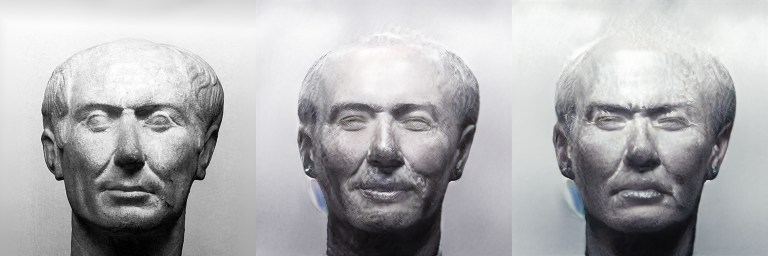

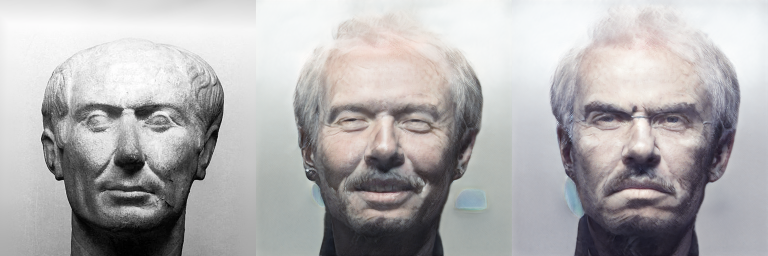

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
# emotion = "joy"
emotions = ["joy","anger"]
gender = "He"
descr_dict = {"joy":["The person is smiling and mouth open","The person has mouth slightly open","The person is smiling","The person is smiling"],
              "sadness":['The person is sad and crying and bags under eyes' ,'The person is sad and crying and bags under eyes' ,"The person is sad and crying with arched eyebrows and narrow lips","The person is sad and crying with arched eyebrows and narrow lips"],
              "anger":['The person is angry and narrow lips and arched eyebrows','The person is angry and narrow lips and arched eyebrows',"The person is angry and narrow lips and arched eyebrows","The person is angry"],
              "love":['The person is in love, smiling and arched eyebrows','The person is in love, smiling and narrow lips','The person is in love, smiling and narrow eyes','The person is smiling and narrow eyes'],
              "fear":['The person is afraid and scared, has mouth slightly open and big eyes and sad','The person is afraid and scared, has mouth slightly open and big eyes and sad','The person is afraid and scared, has big eyes, mouth slightly open and sad' ,'The person is afraid, has big eyes and smiling and sad'  ],
              "surprise":['The person is surprised, smiling and mouth open and big eyes','The person is surprised, smiling and big eyes','The person is surprised, smiling and big eyes','The person is smiling and big eyes' ]}
og_dict = {"joy":"The person is happy","sadness":"The person is sad","anger":"The person is angry","love":"The person is in love","fear":"The person is afraid","surprise":"The person is surprised"}
clip_rate_list = [2.5,2.0,1.5,1.0]
iter_list = [200,100,50,50]
show_orig=True
image_path = "examples/574_01.png"  #MAKE SURE THE CORRESPONDING image is in your examples folder
img_name = image_path[image_path.index("/")+1:image_path.index(".")]
print("results/inversion/test/"+img_name+"_ori.png")
result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
og_result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
model_name = "styleganinv_ffhq256"
impath_list = [image_path,"results/inversion/test/"+img_name+"_inv.png", "results/inversion/test/"+img_name+"_inv_inv.png", "results/inversion/test/"+img_name+"_inv_inv_inv.png" ]
for emotion in emotions:
  desc_list = descr_dict[emotion]
  initial = image_path
  final = "results/inversion/test/"+img_name+"_inv_inv_inv_enc.png"
  for i in range(len(desc_list)):
    desc = desc_list[i].replace("The person",gender)
    clip = clip_rate_list[i]
    iter = iter_list[i]
    command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(impath_list[i], model_name, desc, iter, clip)
    print(command)
    os.system(command)
  result_image = cv2.imread(final)  #Output image is HERE
  result_images.append(result_image)

  og_desc = og_dict[emotion].replace("The person",gender)
  command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(image_path, model_name, og_desc, 200, 2.0)
  print(command)
  os.system(command)
  og_image = cv2.imread("results/inversion/test/"+img_name+"_inv.png")
  og_result_images.append(og_image)

result_v = np.hstack(result_images)
result_vog = np.hstack(og_result_images)
cv2_imshow(result_vog)
cv2_imshow(result_v)

##Other scratch experiments


python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling and mouth open' --learning_rate=0.01 --num_iterations=200 --loss_weight_clip=2.5
python invert.py --image_path=results/inversion/test/20_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She has mouth slightly open' --learning_rate=0.01 --num_iterations=100 --loss_weight_clip=2.0
python invert.py --image_path=results/inversion/test/20_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=50 --loss_weight_clip=1.5
python invert.py --image_path=results/inversion/test/20_inv_inv_inv.png --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is smiling' --learning_rate=0.01 --num_iterations=50 --loss_weight_clip=1.0
python invert.py --image_path=examples/20.jpg --model_name=styleganinv_ffhq256 --mode='man' --description=f'She is happy' --learning_rate=0.01 --num_ite

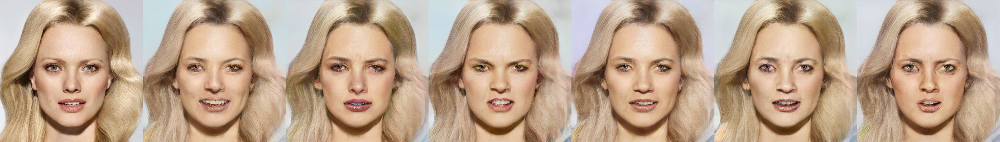

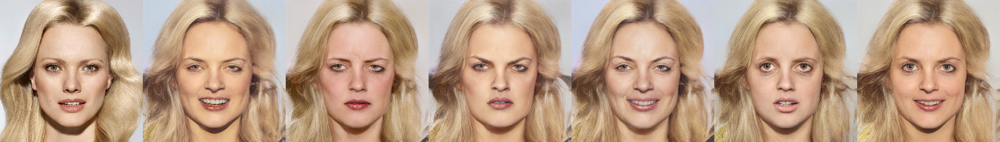

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
# emotion = "joy"
emotions = ["joy","sadness","anger","love","fear","surprise"]
gender = "She"
descr_dict = {"joy":["The person is smiling and mouth open","The person has mouth slightly open","The person is smiling","The person is smiling"],
              "sadness":['The person is sad and crying and bags under eyes' ,'The person is sad and crying and bags under eyes' ,"The person is sad and crying with arched eyebrows and narrow lips","The person is sad and crying with arched eyebrows and narrow lips"],
              "anger":['The person is angry and narrow lips and arched eyebrows','The person is angry and narrow lips and arched eyebrows',"The person is angry and narrow lips and arched eyebrows","The person is angry"],
              "love":['The person is in love, smiling and arched eyebrows','The person is in love, smiling and narrow lips','The person is in love, smiling and narrow eyes','The person is smiling and narrow eyes'],
              "fear":['The person is afraid and scared, has mouth slightly open and big eyes and sad','The person is afraid and scared, has mouth slightly open and big eyes and sad','The person is afraid and scared, has big eyes, mouth slightly open and sad' ,'The person is afraid, has big eyes and smiling and sad'  ],
              "surprise":['The person is surprised, smiling and mouth open and big eyes','The person is surprised, smiling and big eyes','The person is surprised, smiling and big eyes','The person is smiling and big eyes' ]}
og_dict = {"joy":"The person is happy","sadness":"The person is sad","anger":"The person is angry","love":"The person is in love","fear":"The person is afraid","surprise":"The person is surprised"}
clip_rate_list = [2.5,2.0,1.5,1.0]
iter_list = [200,100,50,50]
show_orig=True
image_path = "examples/20.jpg"  #MAKE SURE THE CORRESPONDING image is in your examples folder
img_name = image_path[image_path.index("/")+1:image_path.index(".")]
result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
og_result_images = [cv2.imread("results/inversion/test/"+img_name+"_ori.png")]
model_name = "styleganinv_ffhq256"
impath_list = [image_path,"results/inversion/test/"+img_name+"_inv.png", "results/inversion/test/"+img_name+"_inv_inv.png", "results/inversion/test/"+img_name+"_inv_inv_inv.png" ]
for emotion in emotions:
  desc_list = descr_dict[emotion]
  initial = image_path
  final = "results/inversion/test/"+img_name+"_inv_inv_inv_enc.png"
  for i in range(len(desc_list)):
    desc = desc_list[i].replace("The person",gender)
    clip = clip_rate_list[i]
    iter = iter_list[i]
    command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(impath_list[i], model_name, desc, iter, clip)
    print(command)
    os.system(command)
  result_image = cv2.imread(final)  #Output image is HERE
  result_images.append(result_image)

  og_desc = og_dict[emotion].replace("The person",gender)
  command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(image_path, model_name, og_desc, 200, 2.0)
  print(command)
  os.system(command)
  og_image = cv2.imread("results/inversion/test/"+img_name+"_inv.png")
  og_result_images.append(og_image)

result_v = np.hstack(result_images)
result_vog = np.hstack(og_result_images)
cv2_imshow(result_vog)
cv2_imshow(result_v)

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import os
emotion = "sadness"
gender = "He"
descr_dict = {"joy":["The person is smiling","The person is smiling","The person is smiling","The person is smiling"],
              "sadness":['The person is sad and crying and bags under eyes' ,'The person is sad and crying and bags under eyes, arched eyebrows and narrow lips' ,"The person is sad and crying with arched eyebrows and narrow lips","The person is sad and crying with arched eyebrows and narrow lips"],
              "anger":['The person is angry and narrow lips and arched eyebrows','The person is angry and narrow lips and arched eyebrows',"The person is angry and narrow lips and arched eyebrows","The person is angry"],
              "love":['The person is in love, smiling and arched eyebrows','The person is in love, smiling and narrow lips','The person is in love, smiling and narrow eyes','The person is smiling and narrow eyes'],
              "fear":['The person is afraid, has mouth slightly open and big eyes and sad','The person is afraid, has mouth slightly open and big eyes and sad','The person is afraid, has big eyes, mouth slightly open and sad' ,'The person is afraid, has big eyes and smiling and sad'  ],
              "surprise":['The person is surprised, smiling and mouth open and big eyes','The person is surprised, smiling and big eyes','The person is surprised, smiling and big eyes','The person is smiling and big eyes' ]}
og_dict = {"joy":"The person is happy","sadness":"The person is sad","anger":"The person is angry","love":"The person is in love","fear":"The person is afraid","surprise":"The person is surprised"}
clip_rate_list = [3.0,2.5,2.0,1.5]
iter_list = [200,100,100,100]
show_orig=True
image_path = "examples/29007.png"  #MAKE SURE THE CORRESPONDING image is in your examples folder
model_name = "styleganinv_ffhq256"
img_name = image_path[image_path.index("/")+1:image_path.index(".")]

impath_list = [image_path,"results/inversion/test/"+img_name+"_inv.png", "results/inversion/test/"+img_name+"_inv_inv.png", "results/inversion/test/"+img_name+"_inv_inv_inv.png" ]
desc_list = descr_dict[emotion]
initial = image_path
final = "results/inversion/test/"+img_name+"_inv_inv_inv_enc.png"
for i in range(len(desc_list)-1):
  desc = desc_list[i].replace("The person",gender)
  clip = clip_rate_list[i]
  iter = iter_list[i]
  command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(impath_list[i], model_name, desc, iter, clip)
  print(command)
  os.system(command)
result_image = cv2.imread(final)  #Output image is HERE

og_desc = og_dict[emotion].replace("The person",gender)
command = "python invert.py --image_path={} --model_name={} --mode='man' --description=f'{}' --learning_rate=0.01 --num_iterations={} --loss_weight_clip={}".format(image_path, model_name, og_desc, 200, 2.0)
print(command)
os.system(command)
og_image = cv2.imread("results/inversion/test/"+img_name+"_inv.png")

cv2_imshow(og_image)
cv2_imshow(result_image)